In [2]:
import matplotlib.pyplot as plt
import librosa
from IPython.display import Audio
import IPython
import scipy
import time
import pygame
import numpy as np
import urllib.request

pygame 2.1.2 (SDL 2.0.18, Python 3.8.5)
Hello from the pygame community. https://www.pygame.org/contribute.html


In [3]:
filename = 'spectre-copyrighted-ncs-release.mp3'
# y：波形資料
# sr：取樣頻率（Hz）
y, sr = librosa.load(filename)
print(filename)

spectre-copyrighted-ncs-release.mp3


In [4]:
print(y,sr)
print(y.shape)

[ 1.01968975e-08  3.17131632e-09  1.61007829e-09 ... -4.29701005e-17
 -2.28919224e-17  0.00000000e+00] 22050
(4983477,)


In [5]:
Audio(data=y, rate=sr)

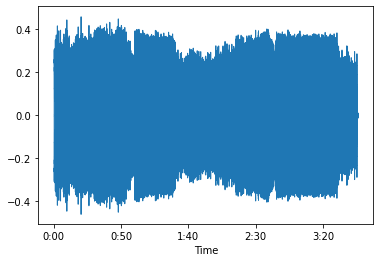

In [6]:
librosa.display.waveshow(y,sr=sr)

In [7]:
onset_env = librosa.onset.onset_strength(y=y, sr=sr)
len(onset_env)
onset_env

array([0.       , 0.       , 0.       , ..., 0.5129279, 0.       ,
       0.       ], dtype=float32)

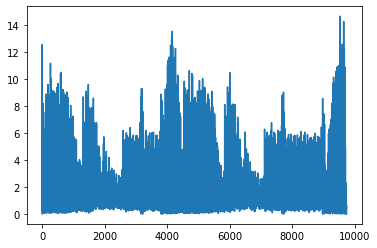

In [8]:
plt.plot(onset_env)

In [9]:
tempo, beat_frames = librosa.beat.beat_track(y=y, sr=sr)
tempo

129.19921875

In [10]:
len(onset_env)
a = np.arange(0,len(onset_env))
a = librosa.frames_to_time(a, sr=sr)
a

array([0.00000000e+00, 2.32199546e-02, 4.64399093e-02, ...,
       2.25953379e+02, 2.25976599e+02, 2.25999819e+02])

In [11]:
# 從頻率分析去找 beat: 有門檻的
threshold = 4
beat = []
for i in range(0,len(onset_env)):
    if onset_env[i] > threshold:
        beat.append([i/sr,onset_env[i]])

In [12]:
test_beat = librosa.frames_to_time(beat, sr=sr)
test_beat

array([[0.        , 0.29129252],
       [0.        , 0.13346939],
       [0.        , 0.19015873],
       ...,
       [0.01015873, 0.2524263 ],
       [0.01015873, 0.17836735],
       [0.01020408, 0.11795918]])

In [13]:
# 從原始波型找
beat_wave = []
for i in range(0,len(y)):
    if y[i] > 0.3:
        beat_wave.append([i/sr,y[i]])

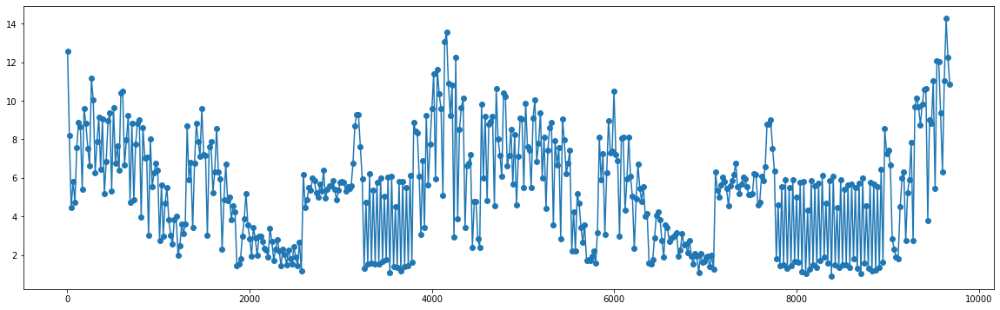

In [14]:
onset = []
for i in range (0,len(beat_frames)):
    onset.append(onset_env[beat_frames[i]])
plt.figure(figsize=(20, 6))
plt.scatter(beat_frames,onset)
plt.plot(beat_frames,onset)

In [15]:
get_onset = []
s = 0
for i in beat_frames:
    if onset_env[i] > 4:
        get_onset.append(i) #把高過的時間丟入陣列裡
        s+=1

get_onset_time = librosa.frames_to_time(get_onset, sr=sr)

In [16]:
#額外增加相對高1.5的
get_onset_rela = []
if onset_env[beat_frames[0]] > 6:
    get_onset_rela.append(beat_frames[0])

for i in range(1,len(beat_frames)):
    if onset_env[beat_frames[i]] > 6 or (onset_env[beat_frames[i]] - onset_env[beat_frames[i-1]] >1.5 and onset_env[beat_frames[i]]>4):
        get_onset_rela.append(beat_frames[i]) #把高過的時間丟入陣列裡
        

get_onset_time_rela = librosa.frames_to_time(get_onset_rela, sr=sr)

In [17]:
big_beat = librosa.frames_to_time(beat_frames, sr=sr)

In [18]:
beat_standard = []
standard = librosa.onset.onset_detect(y=y, sr=sr)
for i in beat_frames:
    if i in standard:
        beat_standard.append(i)
len(beat_standard)

287

In [19]:
# target = get_onset_time
# # target = get_onset_time_rela

# pygame.mixer.init()
# bomb = pygame.mixer.Sound("drum.wav")
# bomb.set_volume(0.6)
# pygame.mixer.music.load(filename)
# pygame.mixer.music.play()
# start = time.time() #起始時間
# print(start)
# i = 0
# while i < len(target):
#     if (time.time()-start) > target[i]:
#         pygame.mixer.Sound.play(bomb)
#         i+=1

In [20]:
# pygame.mixer.music.stop()

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


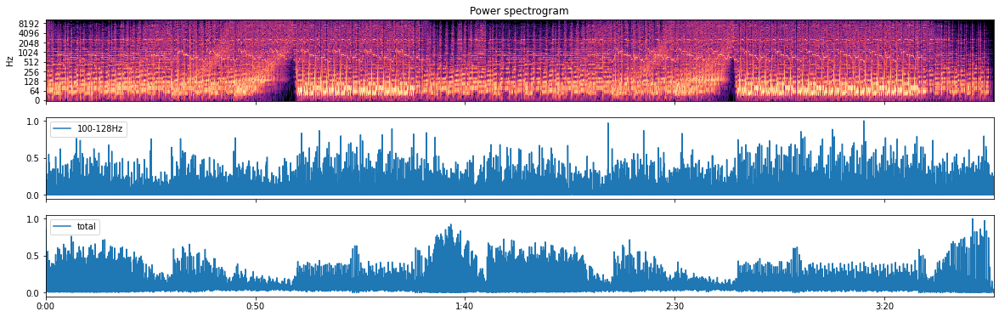

In [21]:
D = np.abs(librosa.stft(y))
times = librosa.times_like(D)
fig, ax = plt.subplots(nrows = 3, sharex = True, figsize=(20, 6))
# plt.figure(figsize=(20, 6))
librosa.display.specshow(librosa.amplitude_to_db(D, ref = np.max), y_axis='log',x_axis='time', ax=ax[0])
ax[0].set(title='Power spectrogram')
ax[0].label_outer()
onset_lowf = librosa.onset.onset_strength(y=y, sr=sr, fmax=128, fmin = 100)
ax[1].plot(times,onset_lowf/onset_lowf.max(),label = '100-128Hz')
ax[1].legend()
onset_total = librosa.onset.onset_strength(y=y,sr=sr)
ax[2].plot(times,onset_total/onset_total.max(),label = 'total')
ax[2].legend()


In [22]:
Audio(data=y, rate=sr)

In [23]:
custom = librosa.onset.onset_strength(y=y,sr=sr,fmax=128)

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


In [24]:
# spec = librosa.feature.melspectrogram(y=y,sr=sr, 
#                                             n_fft=2048, 
#                                             hop_length=512, 
#                                             win_length=None, 
#                                             window='hann', 
#                                             center=True, 
#                                             pad_mode='reflect', 
#                                             power=2.0,
#                                             n_mels=128)

# # step3 converting mel-spectrogrma back to wav file
# res = librosa.feature.inverse.mel_to_audio(spec, 
#                                            sr=sr, 
#                                            n_fft=2048, 
#                                            hop_length=512, 
#                                            win_length=None, 
#                                            window='hann', 
#                                            center=True, 
#                                            pad_mode='reflect', 
#                                            power=2.0, 
#                                            n_iter=32)

In [25]:
# Audio(data=res, rate=sr)

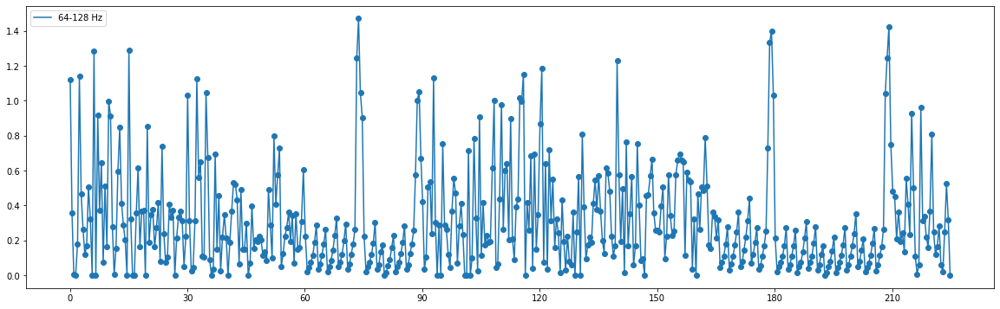

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


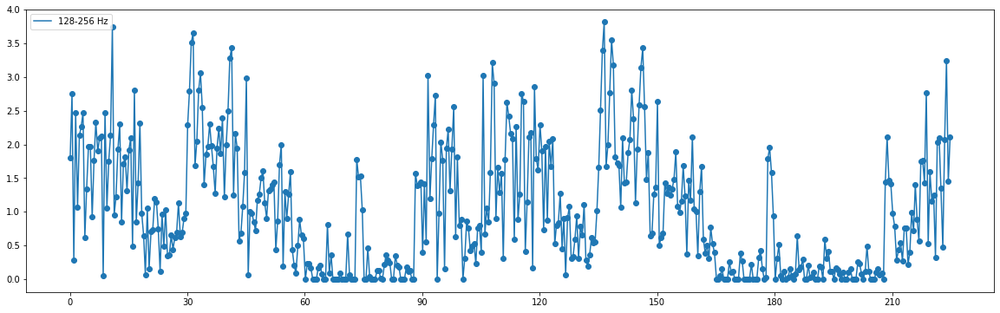

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


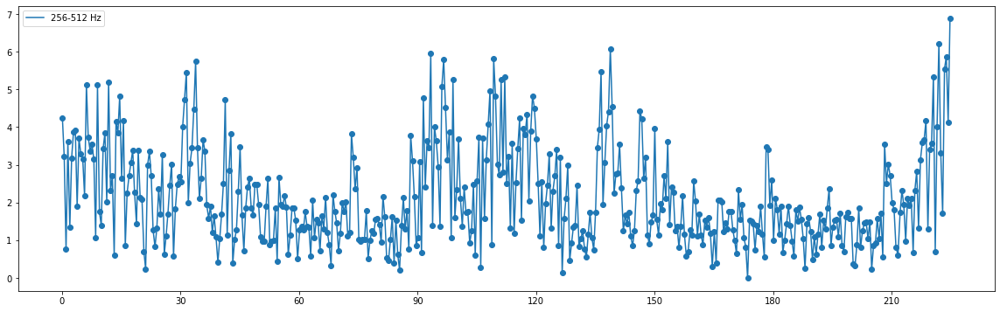

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


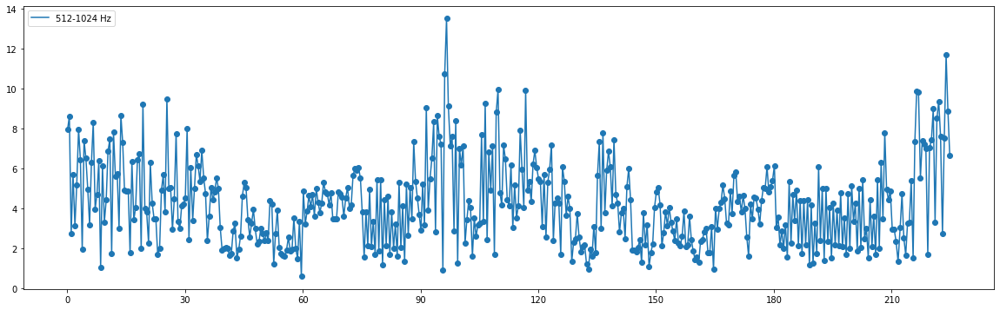

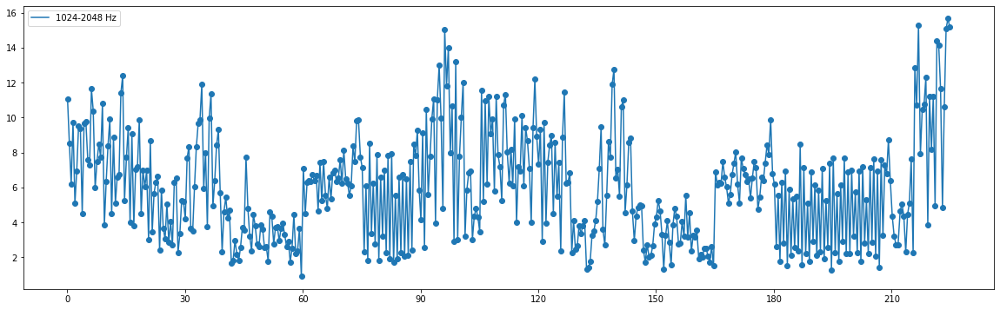

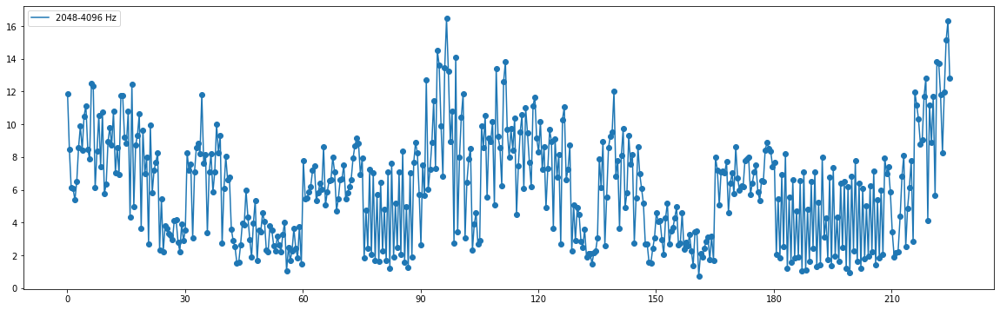

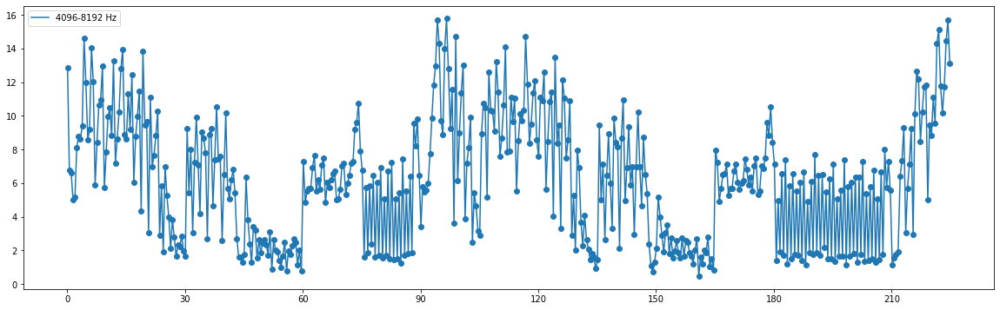

In [26]:
from oo import *
for i in range(0,7):
    onset_data = strength_fre(y,sr,2**(i+1)*64,2**i*64)
    beat_strength_graph(y,sr,beat_frames,onset_data,type = 'time',step = 30,label=f'{2**i*64}-{2**(i+1)*64} Hz')

c:\Users\USER\AppData\Local\Programs\Python\Python38\lib\site-packages\librosa\feature\spectral.py:2157: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = filters.mel(sr=sr, n_fft=n_fft, **kwargs)


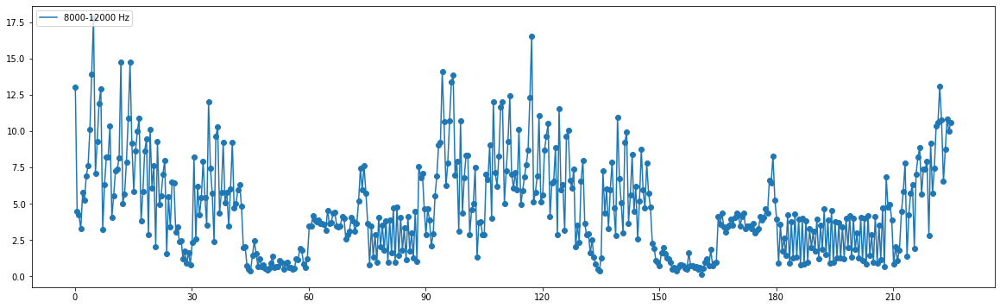

In [27]:
onset_data = strength_fre(y,sr,12000,8000)
beat_strength_graph(y,sr,beat_frames,onset_data,type ='time',step = 30, label='8000-12000 Hz')

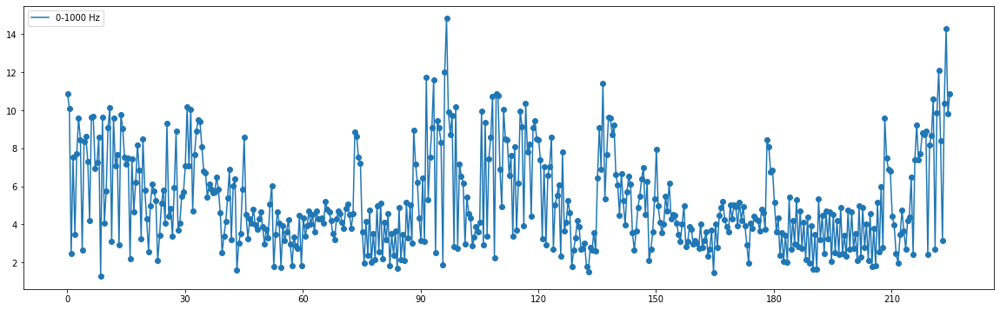

In [28]:
onset_data = strength_fre(y,sr,1000,0)
beat_strength_graph(y,sr,beat_frames,onset_data,type ='time',step = 30, label='0-1000 Hz')

In [29]:
low = []
low_stg = []
high = []
high_stg  = []
threshold = 6
if onset_data[beat_frames[0]] >= threshold:
    high.append(beat_frames[0])
    high_stg.append(onset_data[beat_frames[0]])
else:
    low.append(beat_frames[0])
    low_stg.append(onset_data[beat_frames[0]])

for i in range(1,len(beat_frames)):
    if onset_data[beat_frames[i]] >= threshold or (onset_data[beat_frames[i]] - onset_data[beat_frames[i-1]] >1.5 and onset_data[beat_frames[i]]>3):
        high.append(beat_frames[i])
        high_stg.append(onset_data[beat_frames[i]])

    else:
        low.append(beat_frames[i])
        low_stg.append(onset_data[beat_frames[i]])
low_time = librosa.frames_to_time(low, sr=sr)
high_time = librosa.frames_to_time(high, sr=sr)

In [30]:
beat_times = librosa.frames_to_time(beat_frames, sr=sr)
onset = []
onset_time = []
for i in range (0,len(beat_frames)):
    onset.append(onset_data[beat_frames[i]])
    onset_time.append(beat_times[i])

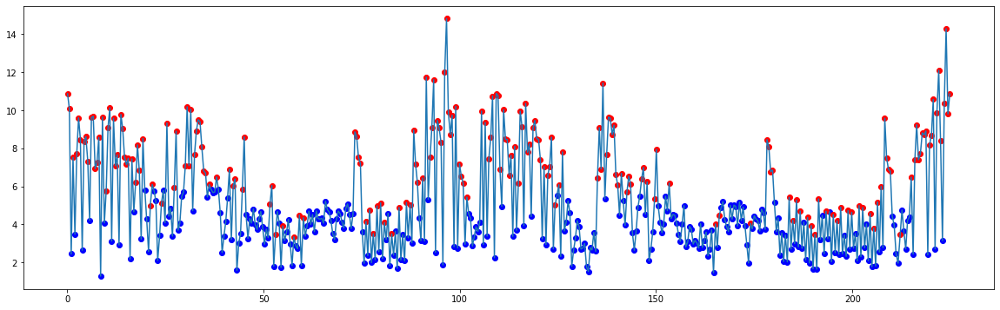

In [31]:
plt.figure(figsize=(20, 6))
plt.scatter(low_time, low_stg, color = 'blue')
plt.scatter(high_time, high_stg, color = 'red')
plt.plot(onset_time,onset)

In [34]:
pygame.mixer.init()
low_sound = pygame.mixer.Sound("drum.wav")
low_sound.set_volume(0.6)
high_sound = pygame.mixer.Sound("high.wav")
high_sound.set_volume(1)
pygame.mixer.music.load(filename)
pygame.mixer.music.play()
start = time.time() #起始時間
i = 0
j = 0
while i < len(low_time) and j < len(high_time):
    if (time.time()-start) > low_time[i]-0.1:
        pygame.mixer.Sound.play(low_sound)
        urllib.request.urlopen(f'http://192.168.130.253/H')
        time.sleep(0.05)
        urllib.request.urlopen(r'http://192.168.130.253/L')
        i+=1
    if (time.time()-start) > high_time[j]-0.1:
        pygame.mixer.Sound.play(high_sound)
        j+=1
    # if (time.time()-start) > stoptime:
    #     pygame.mixer.music.stop()
    #     break

In [ ]:
play_drum(filename,low_time,stoptime=120)

In [33]:
pygame.mixer.music.stop()